# Información

Esta práctica está basada en una similar desarrollada por David Casillas en Matlab para la asignatura de Procesamiento de Señales.

# Construcción del entorno

In [30]:
using Images, TestImages
using StatsBase
using Plots
using ColorTypes
using IndirectArrays

Recuerda ajustar el directorio de trabajo para que existan las imagenes que van a ser usadas.

# Solución
Blázquez Ramírez, Javier.

## Recordatorio de prácticas pasadas y Preparación

**1. Carga la image "board_recorte" y muéstrala**

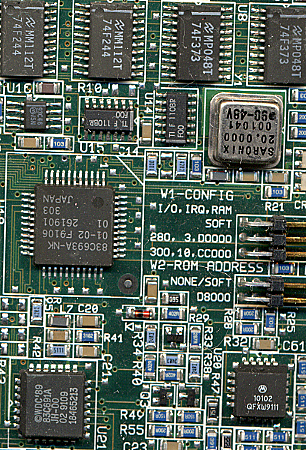

In [31]:
img1 = load("Board_Recorte.tif")

**Separa los canales  de color RGB y muestrelos en una imagen 1x3**

Separamos los canales de la misma manera que lo hemos hecho en prácticas anteriores.

In [32]:
img1_R = red.(img1);
img1_G = green.(img1);
img1_B = blue.(img1);

Ahora que las tenemos separadas, veamos cada canal comparado con la imagen original.

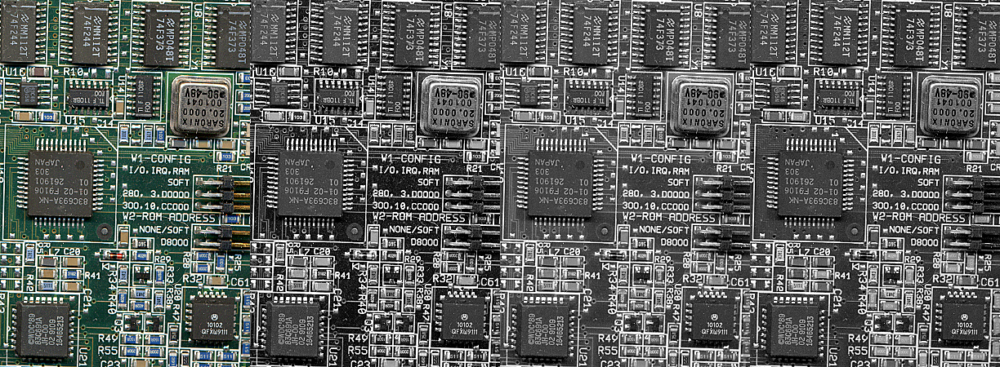

In [33]:
mosaicview(img1,img1_R,img1_G,img1_B; nrow=1)

**Convierte la imagen RGB en HSI y represente cada canal en una imagen de 1x3**

Como sabemos hay dos modalidades de separar las imágenes en canales, una de ellas es RGB, que separa en los canales _Red_, _Green_ y _Blue_. Pero también pueden ser separados en los canales HSI, _Hue_ (Tono), _Saturation_ (Saturación)_ e _Intensity_ (Intensidad).

Veamos estos canales.

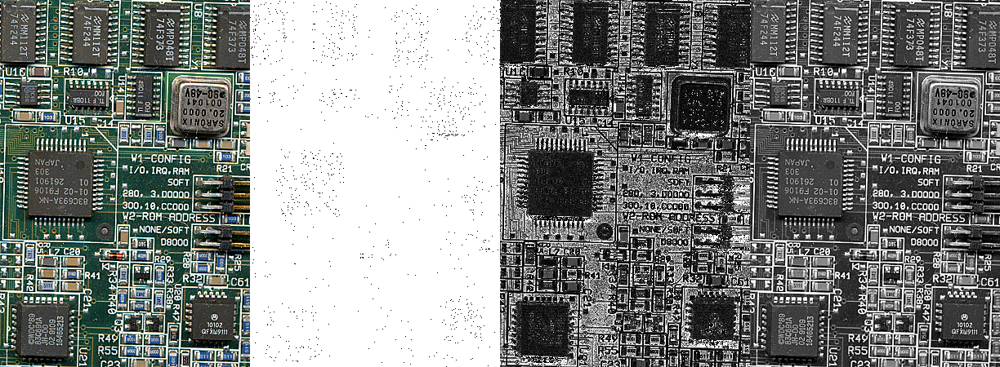

In [34]:
img1_HSI = HSI.(img1);
img1_H = hue.(img1_HSI)
img1_S = channelview(img1_HSI)[2,:, :, ]
img1_I = channelview(img1_HSI)[3,:, :, ]
mosaicview(img1,img1_H, img1_S, img1_I,nrow=1)

**4. Halla el negativo del canal de saturación en "img1_SNeg" y muestra tanto 
el negativo como su histograma en una imagen**

Calculados los diferentes canales, trabajemos ahora con el canal de la Saturación. Calculemos primero su inverso o complementario, se calcula de la misma manera.

Representemos el histograma y el la forma del canal complementario de la Saturación.

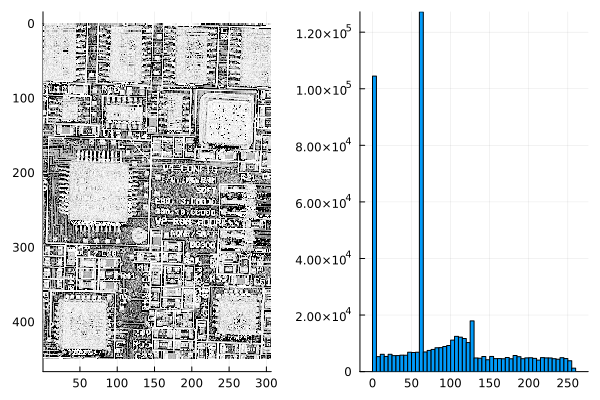

In [35]:
img1_SNeg = 1 .- img1_S;
hist1_SNeg = histogram(vec(reinterpret(UInt8, img1_SNeg)));
plot!( plot(Gray.(img1_SNeg)), hist1_SNeg,
    layout = (1,2),
    legend=false, 
    reuse=false
)

**5. Umbraliza "img1_SNeg" con un nivel obtenido por el método de Otsu, almacena el resultado en "imgB" y 
muéstrala.**

Con el método de Otsu, calcularemos cual es un buen umbral para el umbralizado de la señal, tras este umbralizado, veremos como cambia el canal.

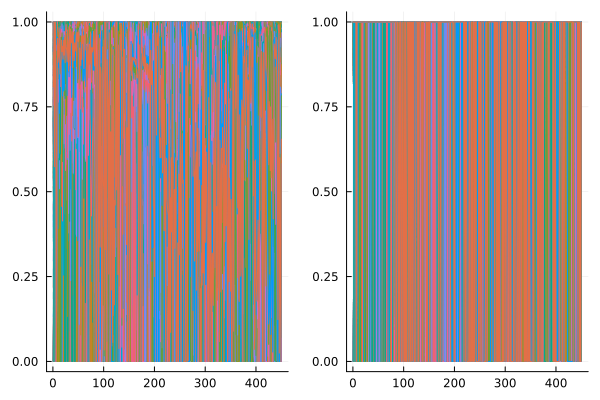

In [36]:
t = find_threshold(img1_SNeg, Otsu(); nbins = 256)
imgB = img1_SNeg .> t
plot!( plot(img1_SNeg), plot(imgB),
    layout = (1,2),
    legend=false, 
    reuse=false
)

Veamos ahora gráficamente, como cambia la imagen. En las imágenes anteriores, vemos como la umbralización ha hecho su efecto y ha variado el canal.

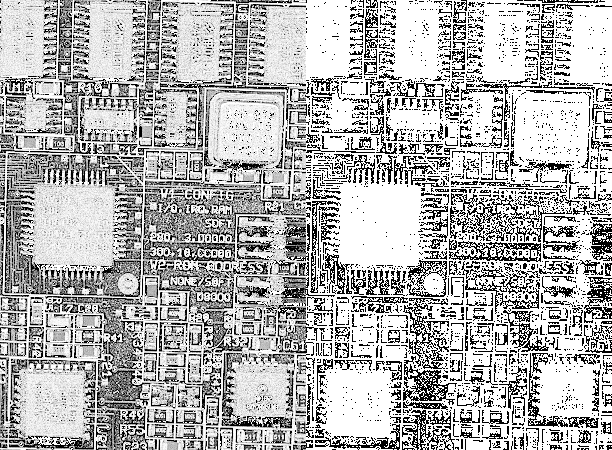

In [37]:
mosaicview(Gray.(img1_SNeg),Gray.(imgB);nrow=1)

Vemos como ahora la imagen solo tiene tonos blancos o negros, se ha binarizado la imagen.

**6. Filtra la imagen imgB con un filtro de mediana 5x5 y compara el resultado.**

Trabajaremos con un filtro de mediana, y una técnica de _Mirror Padding_, para que la amplitud del extremo derecho del histograma no se vea reducido por la técnica del _Zero Padding_.

Veamos representadas la imagen original, el canal Saturación complementario y la imagen filtrada.

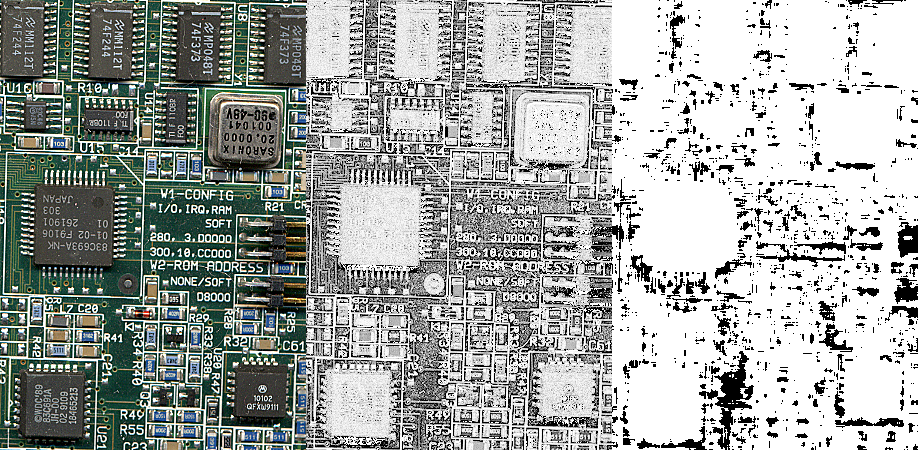

In [38]:
B = mapwindow(median, imgB, (5,5),border="symmetric");
mosaicview(img1,img1_SNeg,B;nrow=1)

Vemos como podemos apreciar, en la imagen filtrada, la de la derecha, todos los bordes de los chips existentes, habiendo reducido mucho el ruido visual de la imagen, y quedándonos solo con lo que nos interesa.

# Procesado Morfológico

Añadimos los paquetes necesarios.

In [39]:
using ImageMorphology
using IndirectArrays

**1. Define un elemento estructurante  cuadrado *centrado* de tamaño 5x5 con la función "strel"**

In [40]:
# Structuring element
size_se = ones(Bool, 5, 5);
se = strel(size_se);

**2. Aplique una apertura a la imagen filtrada anterior "B" con el elemento estructurante anterior 
    y representa la imagen resultante con un título "Opening".**

Como sabemos, la apertura es igual a la dilatación de la erosión de la imagen. Disponemos de una función que nos realiza directamente la apertura, pero comprobemos visualmente, que efectivamente eso ocurre.

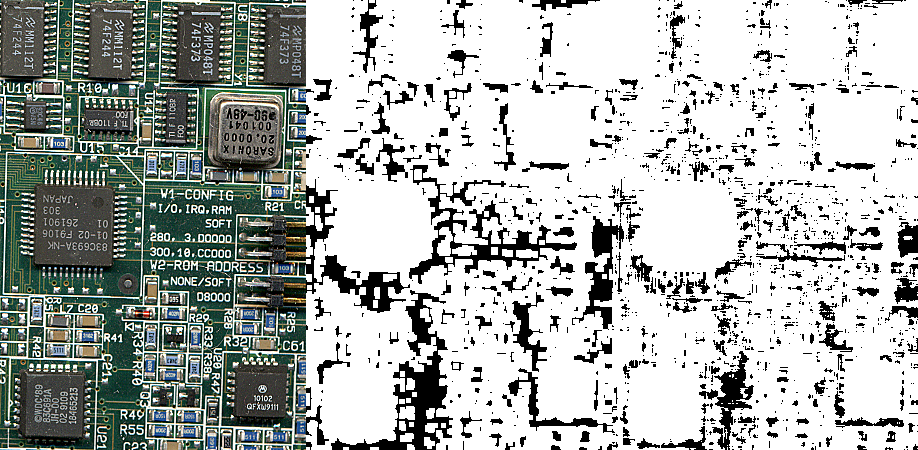

In [41]:
B_open = opening(B,se)
mosaicview(img1,B_open,B;nrow=1)

Ahora de la forma teórica:

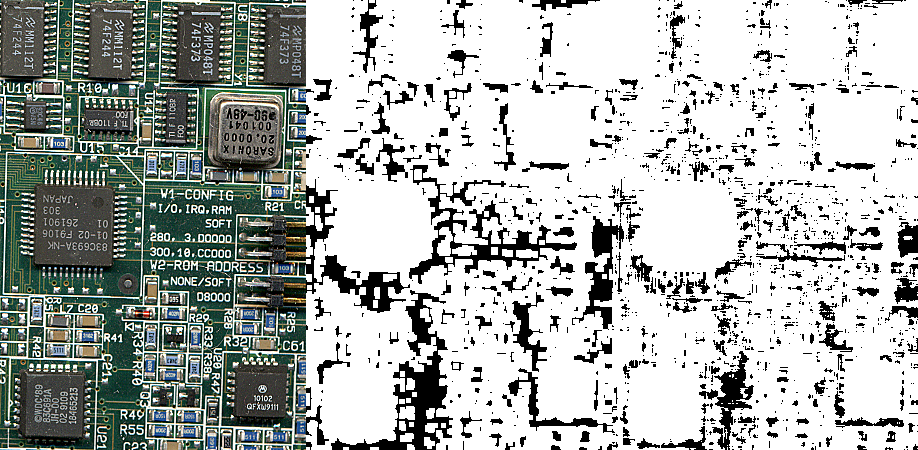

In [42]:
mosaicview(img1,dilate(erode(B,se),se),B,nrow=1)

**3. Lleva a cabo las operaciones de erosión, dilatación y cierre y representa los resultados lado a lado.** 

Calculemos todas las operaciones con el Elemento Estructurante anterior y representemos los resultados.

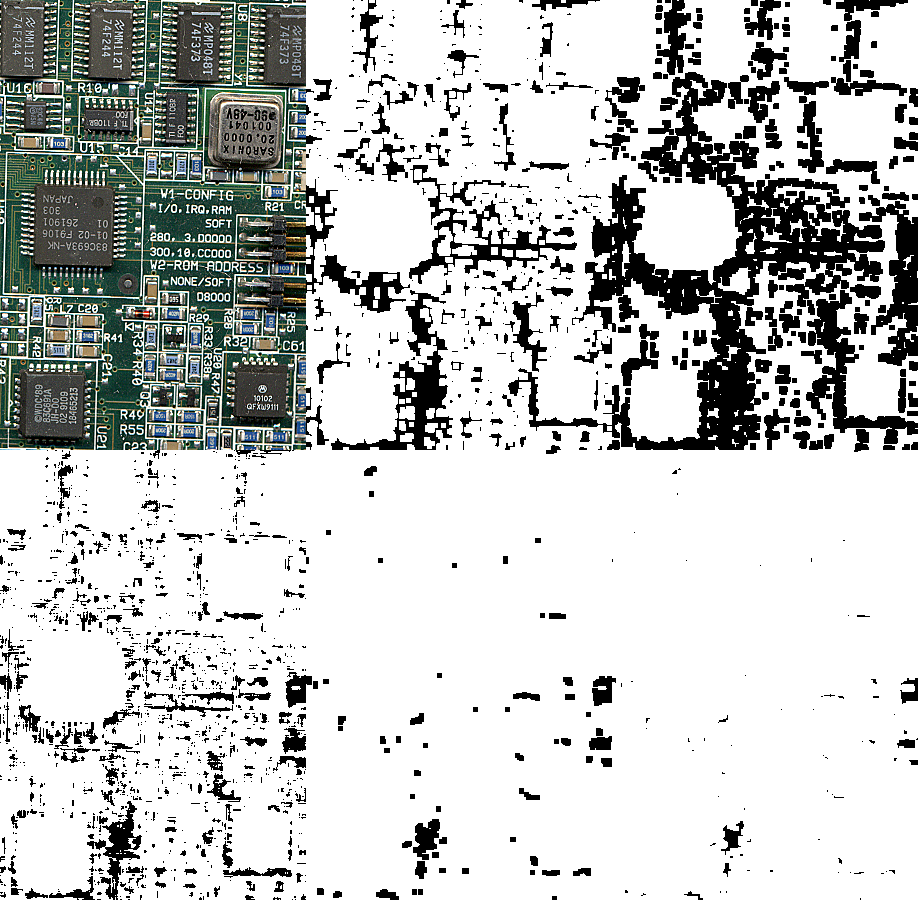

In [43]:
B_eroded = erode(B,se)
B_dilated = dilate(B,se)
B_closed = closing(B,se)
mosaicview(img1,B, B_open, B_closed, B_eroded, B_dilated, nrow=2)

**4. Compruebe que el cierre y la apertura son secuencia de dilataciones y erosiones.**

Los comprobamos y vemos como efectivamente, es verdad.

In [44]:
B_open == dilate(erode(B, se), se)

true

In [45]:
B_closed == erode(dilate(B, se), se)

true

# Segmentación

En esta parte de la práctica vamos a ver en detalle la segmentación 
"por divisoria" (ing. "watershed").

In [46]:
using ImageSegmentation

Para ello vamos a segmentar en granos un corte de roca. Una tarea similar
sería segmentar un corte de tejido celular. 

**1. Carga la imagen "GrainSizeAnalysis.jpg", pásala a tonos de gris, y visualizala.**

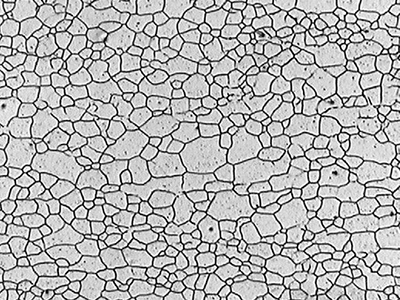

In [47]:
img2 = Gray.(load("GrainSizeAnalysis.jpg"))

**3. Verifica si la imagen original se puede umbralizar de forma sencilla:**

Para que se puede verificar si se puede umbralizar de forma sencilla nos fijaremos en su histograma.

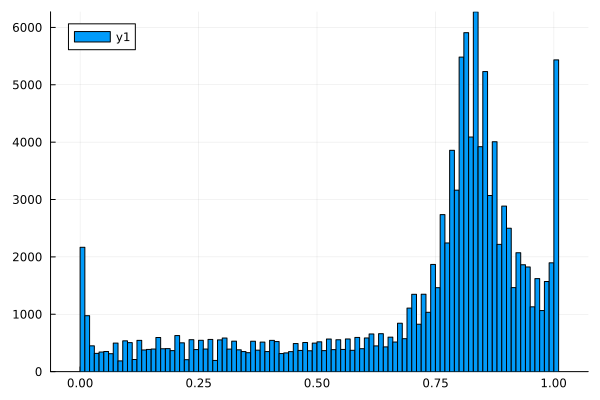

In [48]:
hist2 = histogram(vec(Float64.(img2)))

**Comenta el resultado.**
Como vemos la gráfica del histograma, tiene varias distribuciones claras. 

Los picos en ambos extremos nos indican que estamos ante una distribución bimodal, pero además de todo ello, tenemos una distribución uniforme que recorre el espacio entre ambos picos.

Por tanto, sí que podremos umbralizar, pero deberemos tener especial cuidado a la hora de elegir el valor del umbral.

**3. Usa el tipo de umbralización adecuado a la exploración anterior:**

Como queremos que el umbral equilibre la información de ambas distribuciones, acudiremos al método de Yen para calcular el umbral. Este método es especialmente útil cuando se busca ese equilibrio.

El valor umbral encontrado es: 0.68359375


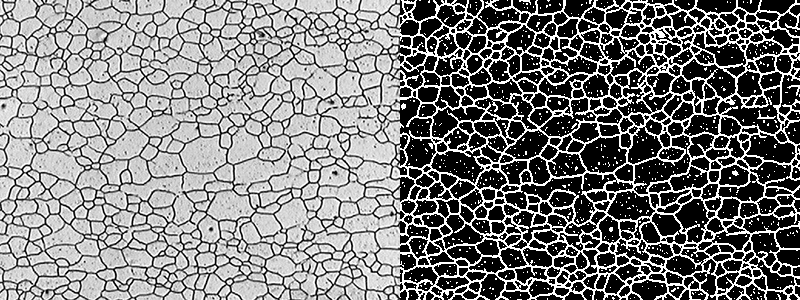

In [49]:
t = find_threshold(img2, Yen(); nbins = 256)
println("El valor umbral encontrado es: ",t)
img2_bw = img2 .< t

mosaicview(img2,img2_bw;nrow=1)

Como queremos segmentar por regiones, buscaremos las fronteras entre regiones, queremos que esas fronteras estén en nuestro primer plano, representadas con el color blanco. A diferencia de otras ocasiones en donde queríamos que esas fueran pertenecientes al fondo.

Por ello, hemos decidido dar la vuelta al signo del umbral.

**5. El proceso de la divisoria comienza encontrando puntos en blanco y sus distancias. Para eso se usa "feature_transform" y "distance transform".**

In [50]:
bw_transform = feature_transform(img2_bw);
dist = 1 .- distance_transform(bw_transform);

**6.Ahora decidimos qué pertenece a cada "watershed". Lee y comprende el siguiente algoritmo. SI es necesario, mira las primitivas "watershed" y "label_map".** 

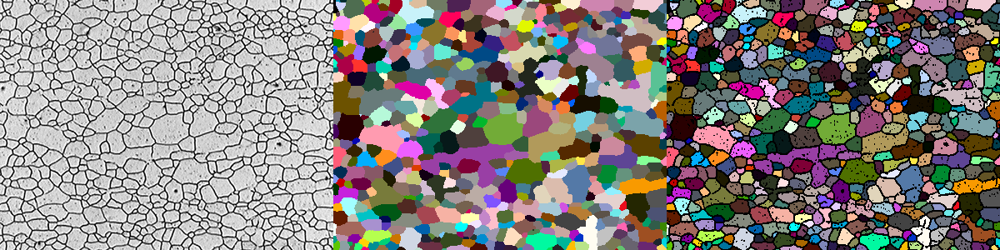

In [51]:
dist_trans = dist .< 1
markers = label_components(dist_trans)
Gray.(markers/32.0)
segments = watershed(dist, markers)
labels = labels_map(segments)
colored_labels = IndirectArray(labels, distinguishable_colors(maximum(labels)))
masked_colored_labels = colored_labels .* (1 .- img2_bw)
mosaicview(img2, colored_labels, masked_colored_labels; nrow=1)

**Comenta el resultado.**
Vemos como hemos obtenido las regiones separadas en diferentes colores, que representan diferentes etiquetas. Con este método hemos conseguido separar en regiones diferentes las regiones iniciales de la imagen original.

**7. ¿Se te ocurre alguna idea para mejorar este resultado? Explora tu solución.**

Podemos mejorar estos resultados, uno de ellos sería optimizar el umbral. Para ello, podemos aplicar primero un filtrado a la imagen, que nos devuelva una imagen con los bordes más claros, para optimizar el umbral y su posterior separación regiones.

Aplicaremos un filtro de apertura. Los filtros de apertura son utilizados para eliminar protuberancias donde no quepa el Elemento Estructurante, haciendo que los objetos queden separados por puntos estrechos. Ejecutemos esta posible implementación.

El valor umbral encontrado es: 0.6213235


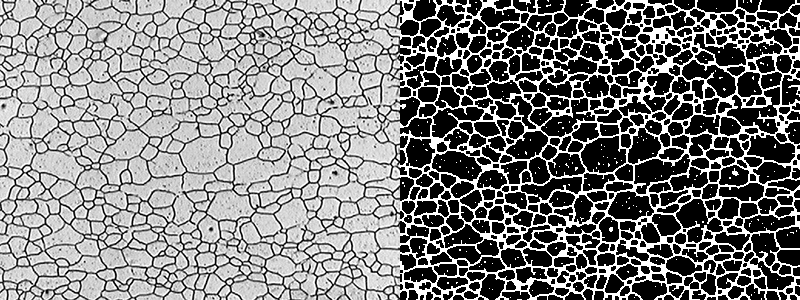

In [52]:
# Construimos un EE de 3x3
size_se = ones(Bool,3,3);
se = strel(size_se);
# Aplicamos el filtro
img2_c = opening(img2, se)
# Buscamos de la misma manera el Umbral
t = find_threshold(img2_c, Yen(); nbins = 256)
println("El valor umbral encontrado es: ",t)
img2_bw1= img2_c .< t
#Representamos
mosaicview(img2, img2_bw1;nrow=1)

Antes de seguir comparemos ambas imágenes umbralizadas:

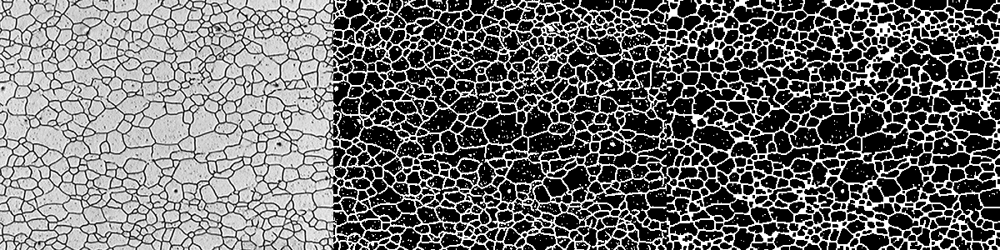

In [53]:
mosaicview(img2,img2_bw,img2_bw1;nrow=1)

Vemos cómo además de separar más claramente las regiones, elimina cierto efecto de ruido de la imagen.

Ahora decidimos qué pertenece a cada "watershed".

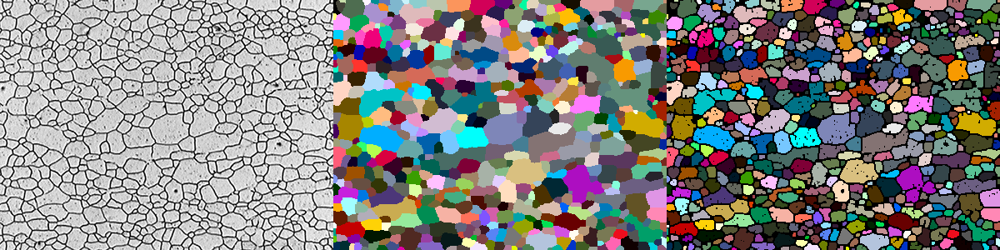

In [54]:
bw_transform = feature_transform(img2_bw1);
dist = 1 .- distance_transform(bw_transform);

dist_trans = dist .< 1
markers = label_components(dist_trans)
Gray.(markers/32.0)
segments = watershed(dist, markers)
labels = labels_map(segments)
my_colored_labels = IndirectArray(labels, distinguishable_colors(maximum(labels)))
my_masked_colored_labels = my_colored_labels .* (1 .- img2_bw1)

mosaicview(img2, my_colored_labels, my_masked_colored_labels; nrow=1)

Comparemos ahora ambas máscaras coloreadas.

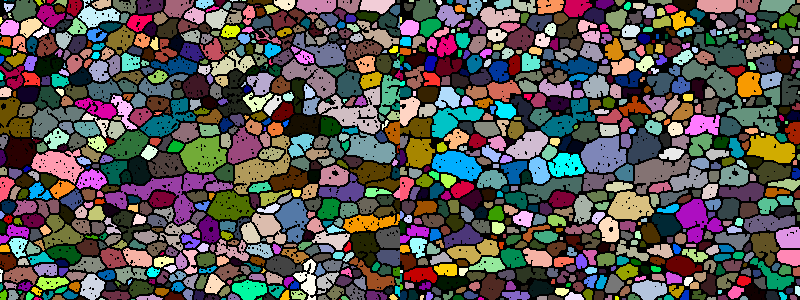

In [55]:
mosaicview(masked_colored_labels,my_masked_colored_labels;nrow=1)

Como el filtro de apertura es un filtro **idempotente**, no obtenemos ninguna ventaja si realizamos un filtro de apertura sobre una imagen ya filtrada, de hecho, obtenemos la misma. Si quisieramos seguir mejorando la detección habría que probar otros métodos.

# Autoevaluación

En este último apartado, registre qué competencias ha entrenado en
esta práctica.

Hoy en día, cada vez hay más noticias sobre inteligencias artificiales o algoritmos capaces de detectar objetos, personas, animales y un largo etcétera. En esta práctica hemos visto la introducción a esta detección de objetos gracias a la **Segmentación**.

Es importante, y cada vez más, que estas detecciones sean fiables, pues de ellas pueden llegar a depender vidas humanas. Hemos avanzado hacia una detección de objetos, aplicando varias operaciones a las imágenes para ser capaces de generar esta detección lo más correcta posible.

Tras esto, hay un largo marco teórico-práctico en el que se puede avanzar para que esta detección sea óptima.

Además de esto, hemos visto como es importante saber con que canales debemos de trabajar para los resultados deseados.